# 1. Análise Exploratória

## Datasets

Para esse projeto serão utilizados 3 datasets:
- Celeb-DF: 
    Link: https://www.kaggle.com/datasets/reubensuju/celeb-df-v2

- FaceForensics:
    Link: https://www.kaggle.com/datasets/sorokin/faceforensics
    
- DFDC: 
    Link:https://www.kaggle.com/competitions/deepfake-detection-challenge/data


Os datasets serão armazenados no diretório data conforme a estrutura a seguir:

...

    ├── data                            <- Diretório de dados.
    │   ├── external                    <- Diretório de dados externos(temporário).
    │   │   └── input_video             <- Diretório para armazenar o vídeo recebido via 
    │   │                                  upload para classificação.
    │   │   
    │   ├── interim                     <- Diretório de dados em processamento (temporário).
    │   │   └── faces                   <- Diretório para armazenar os frames processados 
    │   │                                  do vídeo recebido via upload para classificação.
    │   │
    │   ├── processed                   <- Diretório de dados processados.
    │   │   ├── dataset_celebdf         <- Diretório de faces do dataset celebdf
    │   │   │   └── real_face           <- Diretório de faces reais
    │   │   │   └── fake_face           <- Diretório de faces falsas
    │   │   │
    │   │   ├── dataset_faceforensics   <- Diretório de faces do dataset faceforensics
    │   │   │   └── real_face           <- Diretório de faces reais
    │   │   │   └── fake_face           <- Diretório de faces falsas
    │   │   │
    │   │   └── dataset_dfdc            <- Diretório de faces do dataset dfdc
    │   │       └── real_face           <- Diretório de faces reais
    │   │       └── fake_face           <- Diretório de faces falsas
    │   │   
    │   └── raw                         <- Diretório de dados brutos.
    │       ├── dataset_celebdf         <- Diretório de vídeos do dataset celebdf
    │       │   └── real_video          <- Diretório de vídeos reais
    │       │   └── fake_video          <- Diretório de vídeos falsos
    │       │
    │       ├── dataset_faceforensics   <- Diretório de vídeos do dataset faceforensics
    │       │   └── real_video          <- Diretório de vídeos reais
    │       │   └── fake_video          <- Diretório de vídeos falsos
    │       │
    │       └── dataset_dfdc            <- Diretório de vídeos do dataset dfdc
    │           └── real_video          <- Diretório de vídeos reais
    │           └── fake_video          <- Diretório de vídeos falsos
...

In [ ]:
# Bibliotecas
import pandas as pd
from glob import glob
import cv2
import numpy as np
from IPython.display import HTML
from base64 import b64encode
import matplotlib.pyplot as plt
%matplotlib inline

In [1]:
# Funções para análise exploratória:
def display_img(video):
    cap = cv2.VideoCapture(video)  # take 1 picture
    ret, frame = cap.read()
    fig = plt.figure(figsize=(8,8))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

def explora(dataset):
    # Lista de vídeos:
    videos_reais = glob("../data/raw/dataset_"+ dataset +"/real_video/*.mp4")
    videos_fakes = glob("../data/raw/dataset_"+ dataset +"/fake_video/*.mp4")
    # Totais:
    total_reais = len(videos_reais)
    total_fakes = len(videos_fakes)
    print("Total de vídeos: ", total_reais + total_fakes)
    print("Total de vídeos reais: ", total_reais)
    print("Total de vídeos falsos: ", total_fakes)
    # Cria dataframe de identificação
    dataframe_videos_reais =  pd.DataFrame( data = {"video": videos_reais, "label" : "1", "descricao": "REAL"})
    dataframe_videos_fakes =  pd.DataFrame( data = {"video": videos_fakes, "label" : "0", "descricao": "FAKE"})
    dataframe_videos = pd.concat([dataframe_videos_reais, dataframe_videos_fakes])
    del dataframe_videos_reais, dataframe_videos_fakes
    dataframe_videos.to_csv("../data/raw/dataset_"+ dataset +"/metadados.csv",sep=";", index=False)
    # Plot gráfico
    print("\nGráfico dos quantitativos:")
    display(dataframe_videos['descricao'].value_counts().plot.bar())
    return videos_reais, videos_fakes, dataframe_videos

def display_img(video):
    cap = cv2.VideoCapture(video) 
    ret, frame = cap.read()
    fig = plt.figure(figsize=(8,8))
    ax = fig.add_subplot(111)
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    ax.imshow(frame)

def visualiza_video(video):
    video_url = open(video,'rb').read()
    data_url = "data:video/mp4;base64," + b64encode(video_url).decode()
    return HTML("""<video width=500 controls><source src="%s" type="video/mp4"></video>""" % data_url)


*** 
### CELEB-DF:

Informações de quantitativos:

Total de vídeos:  6529
Total de vídeos reais:  890
Total de vídeos falsos:  5639

Gráfico dos quantitativos:


<Axes: xlabel='descricao'>

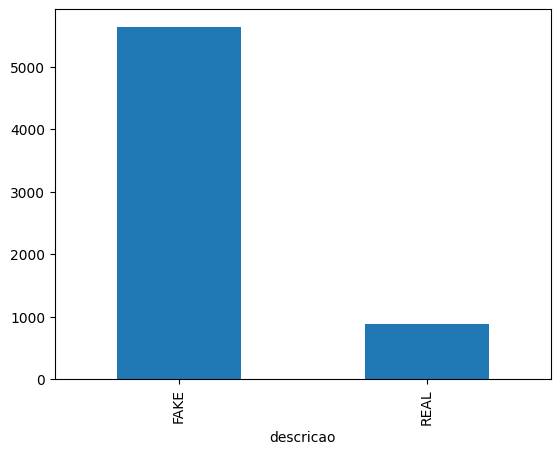

In [5]:
dataset ='celebdf'
videos_reais, videos_fakes, df_videos = explora(dataset)

Exemplo de um frame de um vídeo real:

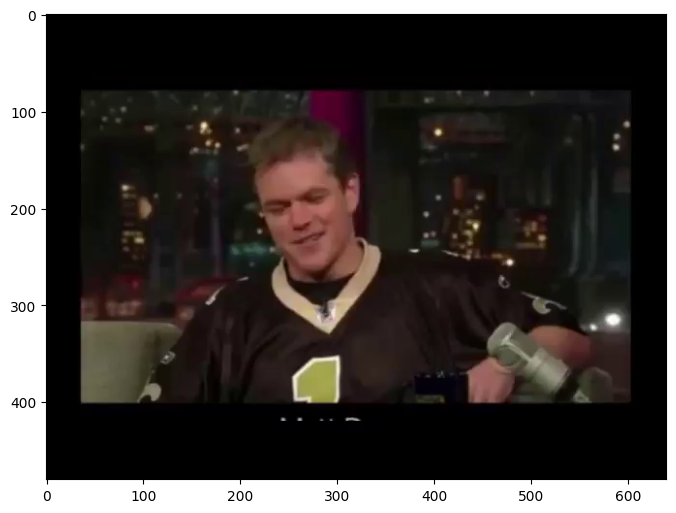

In [6]:
display_img(videos_reais[0])

Exemplo de um vídeo real: 

In [7]:
visualiza_video(videos_reais[0])

Exemplo de um frame de um vídeo fake:

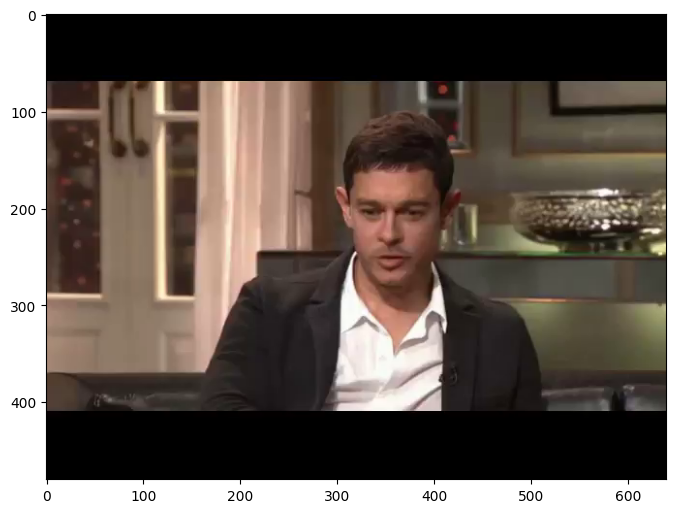

In [8]:
display_img(videos_fakes[0])

Exemplo de um vídeo Fake: 

In [9]:
visualiza_video(videos_fakes[0])

***

### FaceForensics++:

Informações de quantitativos:

Total de vídeos:  5000
Total de vídeos reais:  1000
Total de vídeos falsos:  4000

Gráfico dos quantitativos:


<Axes: xlabel='descricao'>

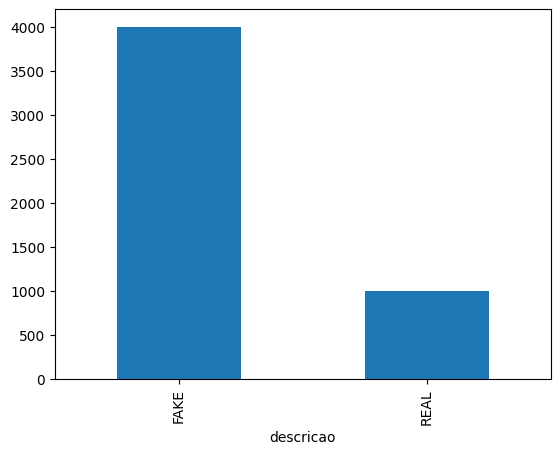

In [20]:
dataset ='faceforensics'
videos_reais, videos_fakes, df_videos = explora(dataset)

Exemplo de um frame de um vídeo real:

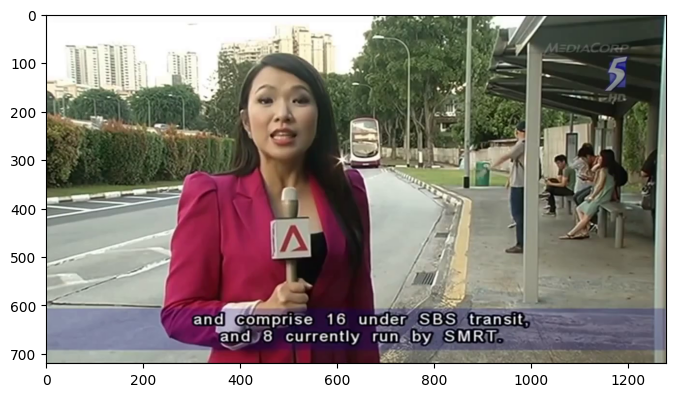

In [21]:
display_img(videos_reais[0])

Exemplo de um vídeo real: 

In [22]:
visualiza_video(videos_reais[0])

Exemplo de um frame de um vídeo fake:

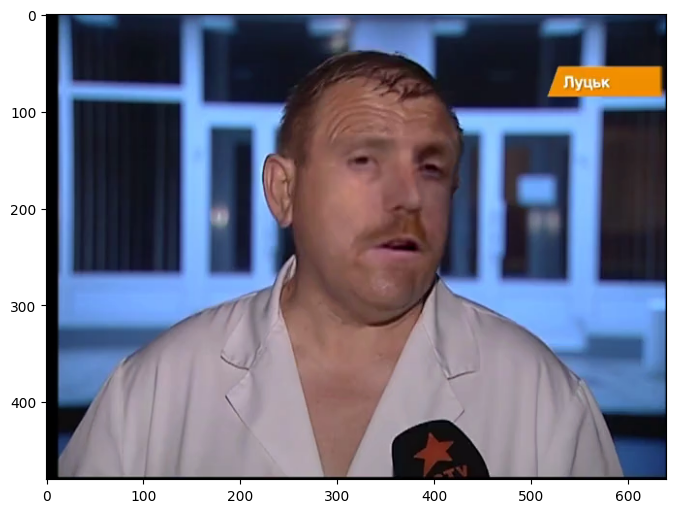

In [23]:
display_img(videos_fakes[0])

Exemplo de um vídeo Fake: 

In [25]:
visualiza_video(videos_fakes[0])

***

### DFDC:

Informações de quantitativos:

Total de vídeos:  800
Total de vídeos reais:  277
Total de vídeos falsos:  523

Gráfico dos quantitativos:


<Axes: xlabel='descricao'>

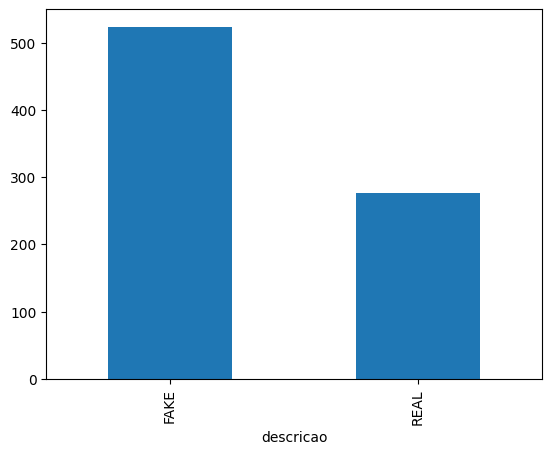

In [15]:
dataset ='dfdc'
videos_reais, videos_fakes, df_videos = explora(dataset)

Exemplo de um frame de um vídeo real:

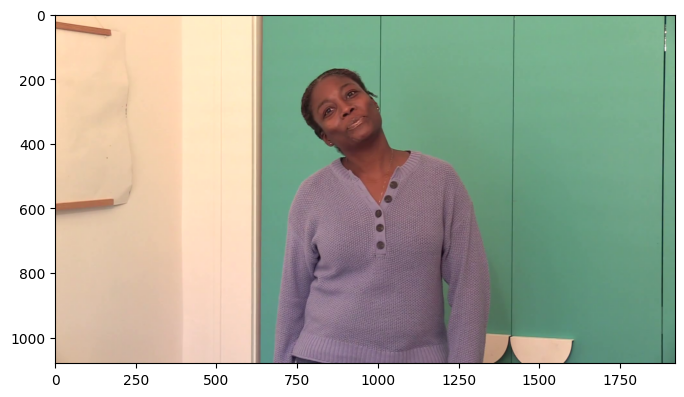

In [16]:
display_img(videos_reais[0])

Exemplo de um vídeo real: 

In [17]:
visualiza_video(videos_reais[0])

Exemplo de um frame de um vídeo fake:

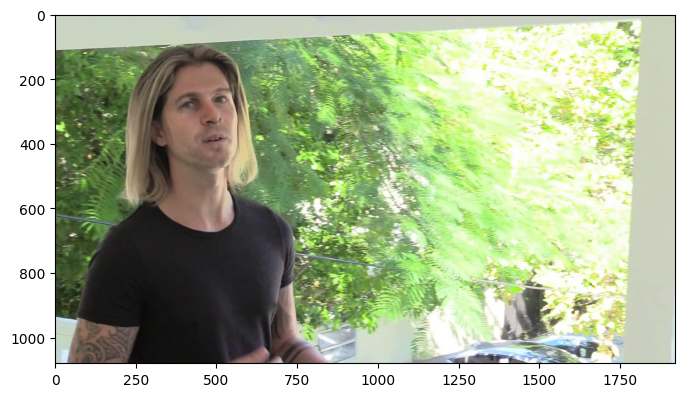

In [18]:
display_img(videos_fakes[0])

Exemplo de um vídeo Fake: 

In [19]:
visualiza_video(videos_fakes[0])

***